In [1]:
!pip install boto3 Pillow -q

import io
import boto3
import json
from PIL import Image, ImageDraw, ExifTags, ImageColor, ImageFont

DEPRECATION: Configuring installation scheme with distutils config files is deprecated and will no longer work in the near future. If you are using a Homebrew or Linuxbrew Python, please see discussion at https://github.com/Homebrew/homebrew-core/issues/76621


In [8]:
bucket = '' 
region = ''
prefix = ''
local_file = ''

In [3]:
client = boto3.client('s3')
s3 = boto3.resource('s3')

# if object is in S3 this can be useful for iterating..
# objects = client.list_objects_v2(Bucket=bucket,Prefix=prefix)

In [4]:
# utility for displaying boxes in images
def markup_image(stream, tr):
    image = Image.open(stream)

    imgWidth, imgHeight = image.size
    draw = ImageDraw.Draw(image)
    
    for b in tr['Blocks']:
        if 'Geometry' in b:
            box = b['Geometry']['BoundingBox']
            left = imgWidth * box['Left']
            top = imgHeight * box['Top']
            width = imgWidth * box['Width']
            height = imgHeight * box['Height']

            try:
                fill='black'
                if b['Confidence'] <90:
                    fill = 'red'
                    print(b['Text'], b['Confidence'])
                    draw.text((left,top), b['Text'], fill)
#                 print(b['Text'], )
            except:
                pass

            points = (
                    (left,top),
                    (left + width, top),
                    (left + width, top + height),
                    (left , top + height),
                    (left, top))
            draw.line(points, fill='#00d400', width=1)
    return image
        

In [5]:
# create textract client
textract_client = boto3.client(
    'textract',
    region_name = region
)

In [ ]:
# read local files into bytes 
f = open(local_file, 'rb')
photo = f.read()
f.close()

In [41]:
# send the bytes to textract and just extract the text
document_text = textract_client.detect_document_text(Document={
    'Bytes': photo

    #    if in S3....
    
#     'S3Object': {
#         'Bucket': bucket,
#         'Name': test_cert
#     }
})


planet: 86.90339660644531
motion. 67.33544921875


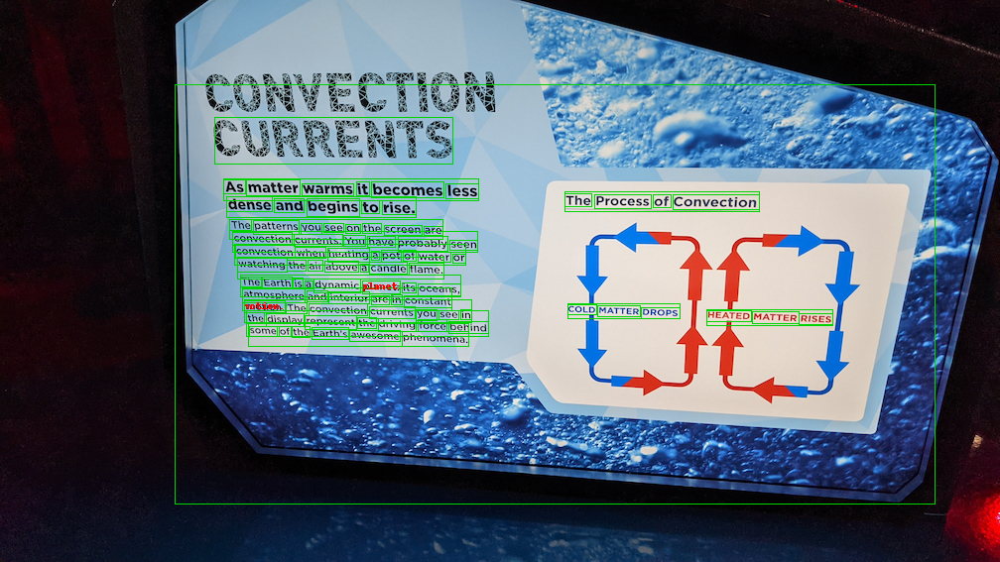

In [43]:
marked_image = markup_image(photo, document_text)
display(marked_image)

In [47]:
# send the bytes to textract and just extract the text
letter = 'testimages/boring_letter.jpg'
# read local files into bytes 
f = open(letter, 'rb')
letter_data = f.read()
f.close()

letter_text = textract_client.analyze_document(
    Document={
        'Bytes': letter_data,
    },
    FeatureTypes=[
        'TABLES','FORMS'
    ]
)


In [48]:
letter_text

{'DocumentMetadata': {'Pages': 1},
 'Blocks': [{'BlockType': 'PAGE',
   'Geometry': {'BoundingBox': {'Width': 1.0,
     'Height': 1.0,
     'Left': 0.0,
     'Top': 0.0},
    'Polygon': [{'X': 0.0, 'Y': 0.000550703436601907},
     {'X': 0.9990234375, 'Y': 0.0},
     {'X': 1.0, 'Y': 0.9994492530822754},
     {'X': 0.0003837738186120987, 'Y': 1.0}]},
   'Id': '2bc300f0-eef7-4735-9cb0-5b755c4eb0a1',
   'Relationships': [{'Type': 'CHILD',
     'Ids': ['b6df8a71-cb9b-4aae-a02b-d9a484032476',
      '5dfeb127-f2ee-4c65-ac62-14053e60c948',
      '3e6c96d4-7cdc-49db-98e1-4c2f728ccd31',
      '59f769e3-b82c-40f0-ba29-1476851e80d7',
      '8e636c42-ca5a-4c81-b496-df36690a5884',
      '73c075e4-301b-4b5f-aefe-d6d161679ccd',
      'faf51a5e-bb30-499d-a1d0-dd4a9720a16f',
      '75f84ce3-3459-4e1d-9399-abfa91b053d4',
      'bd7f66a7-b884-4f80-93ea-d8ac6743239c',
      '28dd7a23-5438-4967-9cf7-96ff54511c31',
      '926b550a-3c06-491b-b7c9-854740377aa1',
      '30a16b35-c9d8-4a6b-990d-1726d4c2cb71',
  

s556 80.03202819824219
s574 75.32562255859375
further information. 77.06890106201172
Pension Rebates (s575 of the Local Gout Act 1993) 88.35869598388672
(s555 62.56615447998047
s556 80.03202819824219
s574 75.32562255859375
charities 56.19695281982422
(s514 53.260921478271484
of the 74.39888763427734
Business. 54.372684478759766
Categories. 89.01651763916016
of the 70.88306427001953
of the 80.13038635253906
notice, 58.55292510986328
of 86.8345947265625
information. 54.26103973388672
(s575 85.75237274169922
of the 62.99851989746094
Gout 63.900901794433594
of the 76.39984130859375
Act 86.69813537597656
purposes. 73.39131927490234
of the 63.229393005371094
specified 43.327964782714844
by 89.62659454345703
notice. 89.52167510986328
110038 61.61811828613281
valuationenquiry@property.nsw.gov.al 73.27662658691406
(s518Bof the 80.81184387207031
outcome. 85.5999526977539
commitment. 81.87201690673828


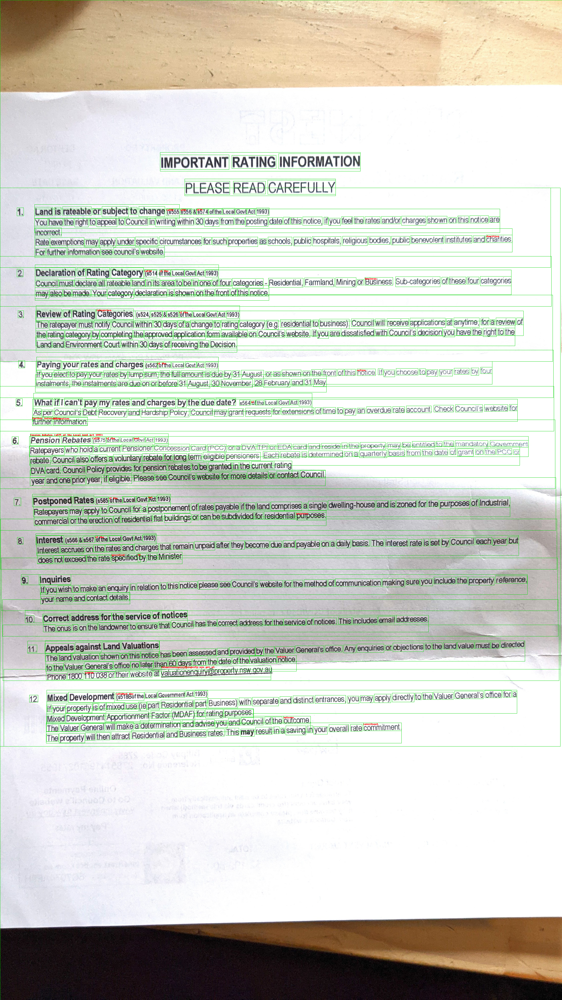

In [51]:
marked_image = markup_image(letter, letter_text)
display(marked_image)

In [6]:
# send the bytes to textract and just extract the text
food = 'testimages/breath_mints.jpg'
# read local files into bytes 
f = open(food, 'rb')
food_data = f.read()
f.close()

food_text = textract_client.analyze_document(
    Document={
        'Bytes': food_data,
    },
    FeatureTypes=[
        'TABLES'
    ]
)


NUTRITION INFORMATION 88.6257553100586
- 88.61599731445312
9 335492 000025"> 47.586326599121094
INFORMATION 80.14714813232422
- 88.61599731445312
9 335492 000025"> 47.586326599121094


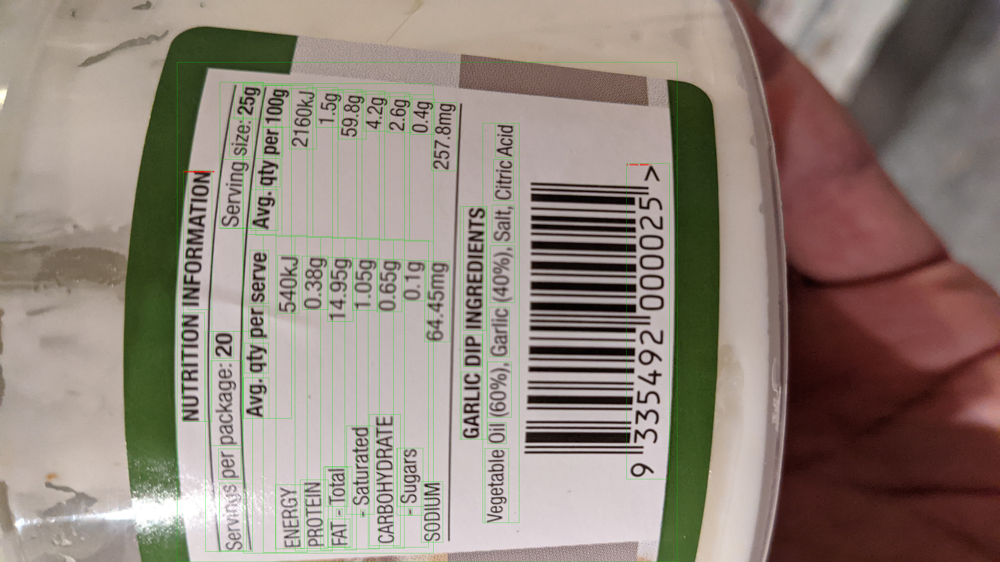

In [7]:
marked_image = markup_image(food, food_text)
display(marked_image)